In [18]:
%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [19]:
import ShallowLearn.LoadData as ld
import pkg_resources

In [20]:
from ShallowLearn.band_mapping import band_mapping
import ShallowLearn.ImageHelper as ih

In [21]:
from ShallowLearn import Indices

In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [23]:
from ShallowLearn.IndiceFeatures import GenerateIndicesPerImage
from ShallowLearn.ImageHelper import load_img

In [24]:
import ShallowLearn.Transform as tf

In [25]:
import os
import glob

# specify the directory path
dir_path = '/media/ziad/Expansion/Cleaned_Data_Directory'

# search for all .tiff files in the directory
file_list = glob.glob(dir_path + '/*6880*.tiff')

# get the full directory paths for each file
dir_list = [os.path.join(dir_path, f) for f in file_list]



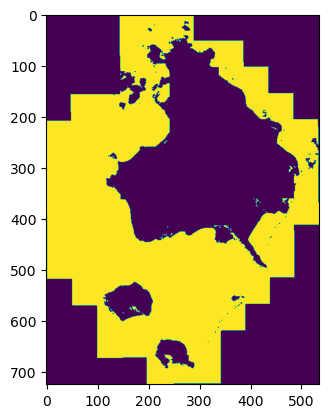

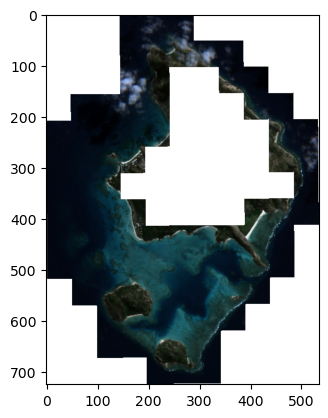

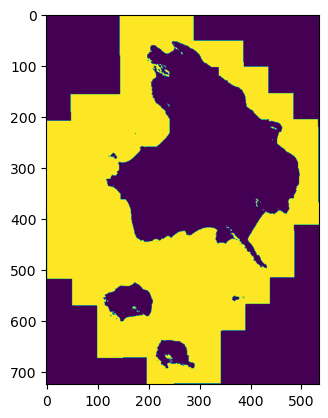

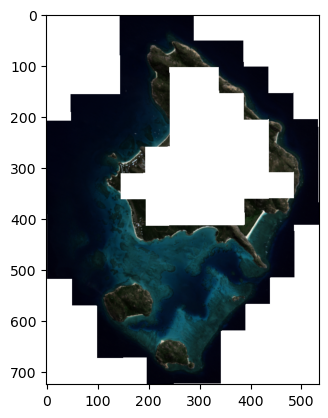

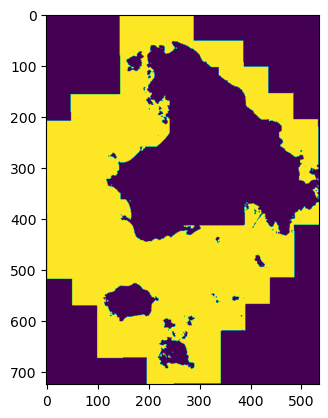

...

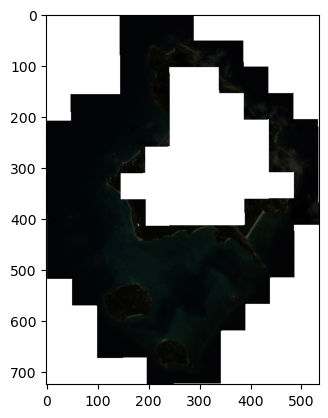

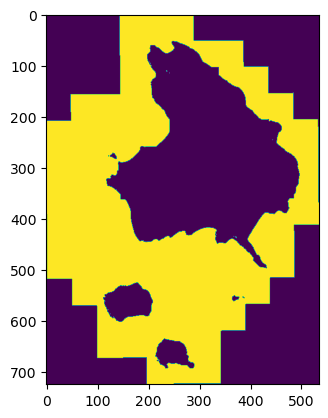

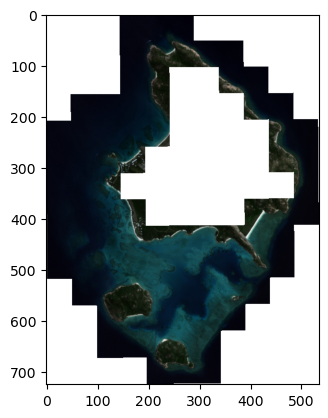

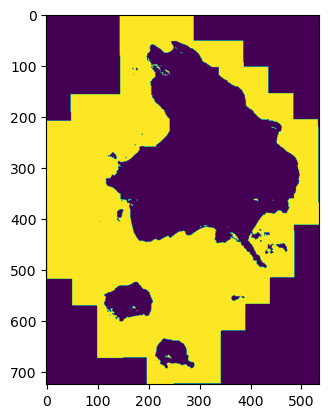

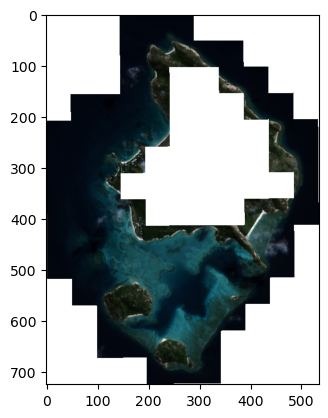

In [26]:
masks = []
good_imagery = []
for i in range(len(dir_list)):
    data = load_img(dir_list[i])
    #plt.imshow(data[:,:,7])
    mask = Indices.mask_land(tf.LCE_multi(data),land_band= 'B08', threshold=50)
    mean = (np.mean(mask))
    if np.mean(mask) < 0.6 and np.mean(mask) > 0.4:
        masks.append(mask)
        good_imagery.append(data)
        plt.imshow(~mask)
        plt.show()
        ih.plot_rgb(tf.LCE_multi(data), plot = True)
        plt.show()  

In [27]:
# data = ih.apply_mask(data, ~mask, fill_value=np.nan)
clipped_imagery = []
for img, mask in zip(good_imagery, masks):
    clipped_imagery.append((ih.apply_mask(img, ~mask, fill_value=np.nan)))

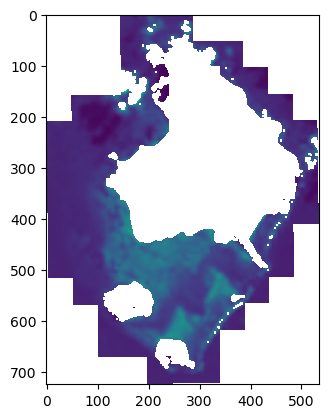

In [28]:
plt.imshow(clipped_imagery[0][:,:,0])

In [29]:

features = GenerateIndicesPerImage(data)


indice_stack = []
for img in clipped_imagery:
    features = GenerateIndicesPerImage(img)
    concated_array = np.concatenate((img, features.indices), axis = 2)
    indice_stack.append(concated_array)

[('bgr', <function bgr at 0x7fa7abde5120>), ('calculate_pseudo_subsurface_depth', <function calculate_pseudo_subsurface_depth at 0x7fa7abde53f0>), ('calculate_subsurface_depth', <function calculate_subsurface_depth at 0x7fa7abde5480>), ('calculate_water_surface_index', <function calculate_water_surface_index at 0x7fa7abde5360>), ('ci', <function ci at 0x7fa7f60b7400>), ('get_band_numbers', <function get_band_numbers at 0x7fa7abde5240>), ('mask_land', <function mask_land at 0x7fa7abde51b0>), ('ndci', <function ndci at 0x7fa7abde5090>), ('oci', <function oci at 0x7fa7abde4e50>), ('ssi', <function ssi at 0x7fa7abde4ee0>), ('ti', <function ti at 0x7fa7abde4f70>), ('validate_band_shape', <function validate_band_shape at 0x7fa7abde52d0>), ('wqi', <function wqi at 0x7fa7abde5000>)]
[('bgr', <function bgr at 0x7fa7abde5120>), ('ci', <function ci at 0x7fa7f60b7400>), ('ndci', <function ndci at 0x7fa7abde5090>), ('oci', <function oci at 0x7fa7abde4e50>), ('ssi', <function ssi at 0x7fa7abde4ee0>)

/home/ziad/Documents/Github/ShallowLearn/ShallowLearn/Indices.py:47: RuntimeWarning: invalid value encountered in divide
  ci = (nir_band - red_band) / (nir_band + red_band + red_edge_band)
/home/ziad/Documents/Github/ShallowLearn/ShallowLearn/Indices.py:195: RuntimeWarning: invalid value encountered in divide
  ndci = (green_band - red_edge_band) / (green_band + red_edge_band) + 1
/home/ziad/Documents/Github/ShallowLearn/ShallowLearn/Indices.py:105: RuntimeWarning: invalid value encountered in divide
  ssi = (nir_band - red_band) / (nir_band + red_band + red_edge_band)


[('bgr', <function bgr at 0x7fa7abde5120>), ('calculate_pseudo_subsurface_depth', <function calculate_pseudo_subsurface_depth at 0x7fa7abde53f0>), ('calculate_subsurface_depth', <function calculate_subsurface_depth at 0x7fa7abde5480>), ('calculate_water_surface_index', <function calculate_water_surface_index at 0x7fa7abde5360>), ('ci', <function ci at 0x7fa7f60b7400>), ('get_band_numbers', <function get_band_numbers at 0x7fa7abde5240>), ('mask_land', <function mask_land at 0x7fa7abde51b0>), ('ndci', <function ndci at 0x7fa7abde5090>), ('oci', <function oci at 0x7fa7abde4e50>), ('ssi', <function ssi at 0x7fa7abde4ee0>), ('ti', <function ti at 0x7fa7abde4f70>), ('validate_band_shape', <function validate_band_shape at 0x7fa7abde52d0>), ('wqi', <function wqi at 0x7fa7abde5000>)]
[('bgr', <function bgr at 0x7fa7abde5120>), ('ci', <function ci at 0x7fa7f60b7400>), ('ndci', <function ndci at 0x7fa7abde5090>), ('oci', <function oci at 0x7fa7abde4e50>), ('ssi', <function ssi at 0x7fa7abde4ee0>)

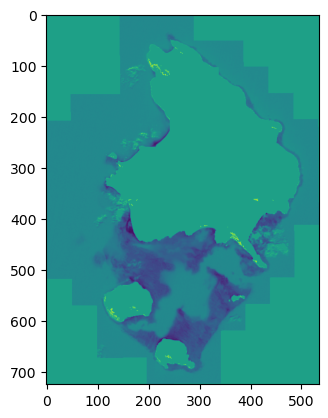

In [30]:
plt.imshow(features.indices[:,:,5])

In [31]:
X_train = np.array(indice_stack).reshape(-1, 20)

In [32]:
X_train

array([[nan, nan, nan, ..., nan,  0., nan],
       [nan, nan, nan, ..., nan,  0., nan],
       [nan, nan, nan, ..., nan,  0., nan],
       ...,
       [nan, nan, nan, ..., nan,  0., nan],
       [nan, nan, nan, ..., nan,  0., nan],
       [nan, nan, nan, ..., nan,  0., nan]])

In [291]:
from ShallowLearn.band_mapping import band_mapping

In [292]:
feature_names = list(band_mapping.keys()) + features.indice_order  

In [293]:
X_train = pd.DataFrame(X_train, columns = feature_names)

In [294]:
X_train = X_train.dropna().drop_duplicates()

In [295]:
X_train

,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B10,B11,B12,bgr,ci,ndci,oci,ssi,ti,wqi
722,1462.0,1057.0,626.0,369.0,361.0,345.0,358.0,248.0,74.0,7.0,260.0,251.0,373.0,1.688498,-0.123722,1.268490,0.678284,-0.123722,-0.195793,425.25
723,1453.0,1038.0,618.0,377.0,340.0,315.0,320.0,228.0,70.0,6.0,220.0,202.0,324.0,1.679612,-0.157672,1.290188,0.907407,-0.157672,-0.245875,412.50
724,1448.0,1053.0,633.0,383.0,353.0,335.0,338.0,230.0,69.0,6.0,212.0,193.0,307.0,1.663507,-0.158385,1.283976,1.061889,-0.158385,-0.249186,426.00
725,1451.0,1048.0,620.0,388.0,349.0,330.0,333.0,209.0,69.0,6.0,200.0,184.0,297.0,1.690323,-0.189218,1.279670,1.087542,-0.189218,-0.299331,421.75
726,1460.0,1050.0,622.0,365.0,327.0,302.0,305.0,209.0,71.0,6.0,183.0,177.0,296.0,1.688103,-0.173141,1.310854,1.101351,-0.173141,-0.271304,404.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20518661,2300.0,1960.0,1579.0,1305.0,1255.0,1232.0,1212.0,1176.0,1056.0,1009.0,1073.0,1053.0,1184.0,1.241292,-0.034529,1.114326,0.333615,-0.034529,-0.051974,1342.75
20518662,2300.0,1965.0,1583.0,1317.0,1254.0,1233.0,1211.0,1184.0,1057.0,1009.0,1072.0,1057.0,1179.0,1.241314,-0.035419,1.115968,0.342663,-0.035419,-0.053157,1346.75
20518663,2300.0,1958.0,1581.0,1322.0,1254.0,1234.0,1212.0,1180.0,1057.0,1009.0,1073.0,1057.0,1179.0,1.238457,-0.037806,1.115344,0.340967,-0.037806,-0.056732,1347.75
20518664,2300.0,1961.0,1585.0,1321.0,1257.0,1234.0,1216.0,1178.0,1057.0,1009.0,1075.0,1053.0,1183.0,1.237224,-0.038072,1.115412,0.339814,-0.038072,-0.057200,1349.25


In [296]:
import seaborn as sns
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.model_selection import GridSearchCV
from sklearn.mixture import GaussianMixture

In [206]:
def plot_histograms(dataframe):

    columns = dataframe.columns
    for column in columns:
        sns.histplot(dataframe[column], kde = True)
        plt.title(column)
        plt.show()

In [207]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PowerTransformer

In [208]:
from sklearn import decomposition
import matplotlib.pyplot as plt

In [209]:
sd = (X_train.sample(250_000, random_state = 42))


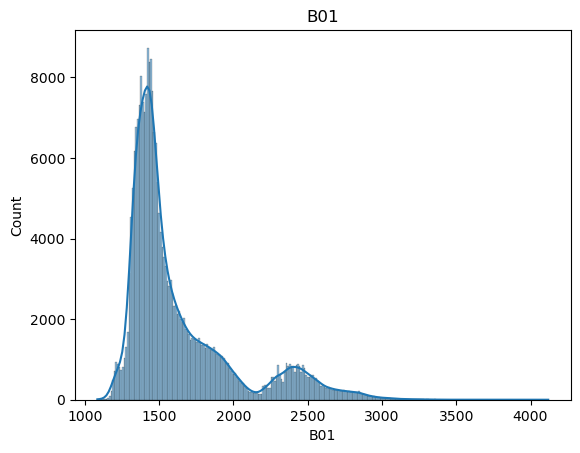

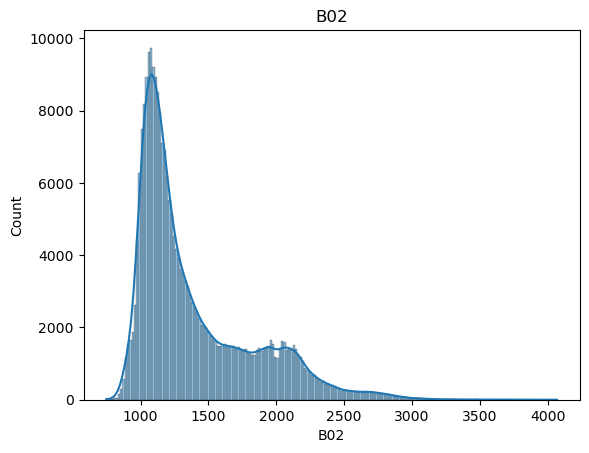

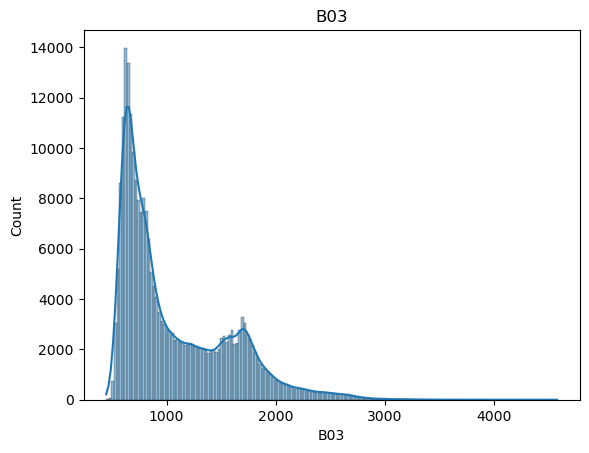

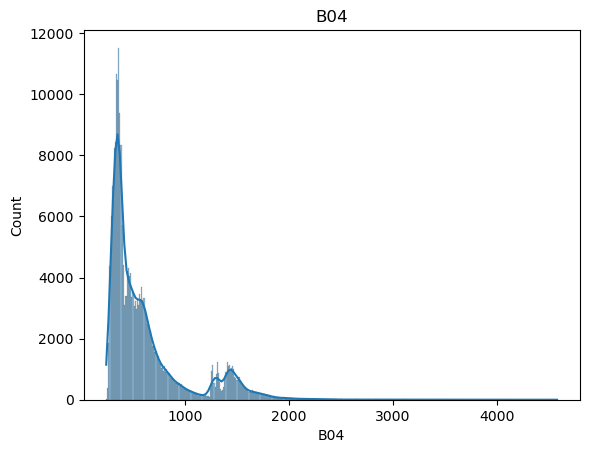

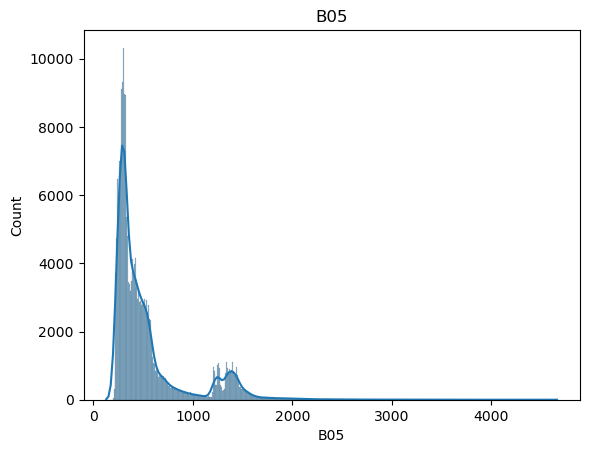

...

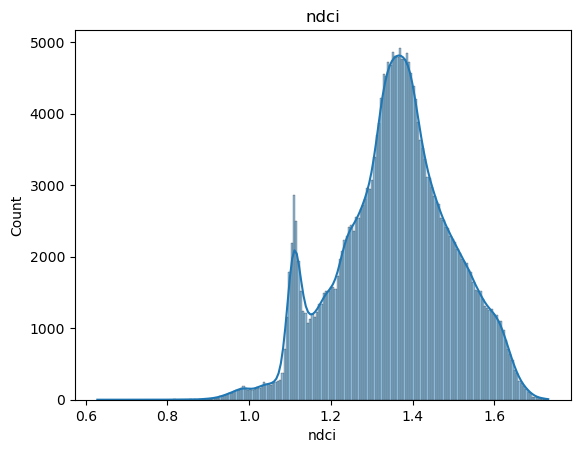

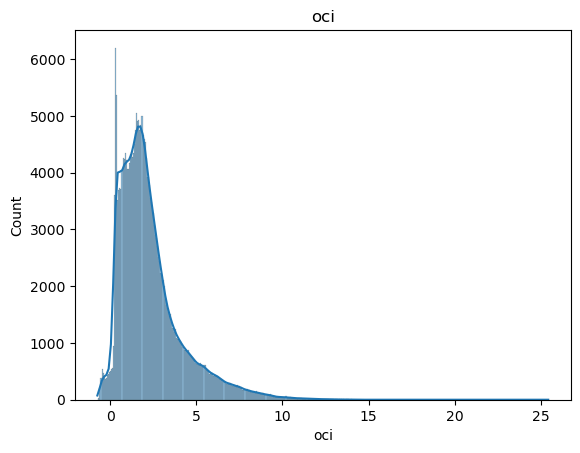

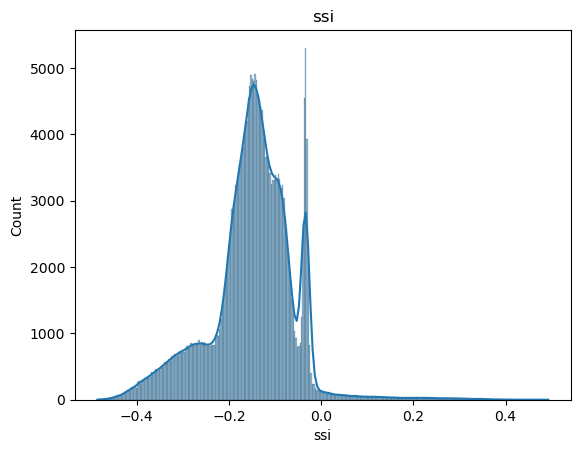

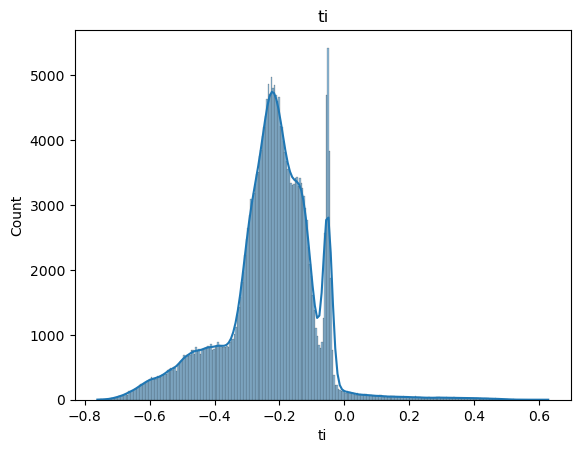

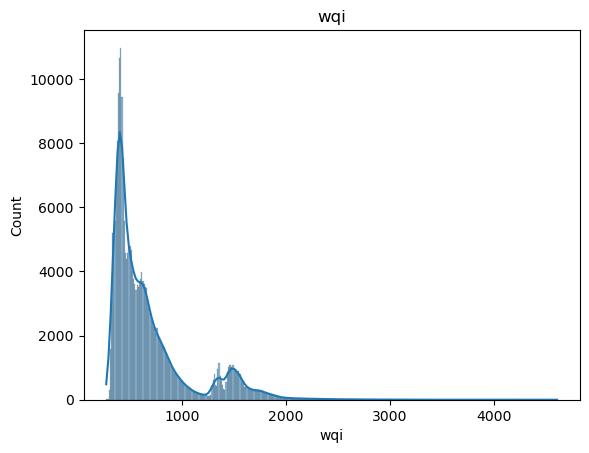

In [210]:
plot_histograms(sd)

In [211]:
pt = PowerTransformer()

In [212]:
sd = pd.DataFrame(pt.fit_transform(sd), columns = sd.columns)

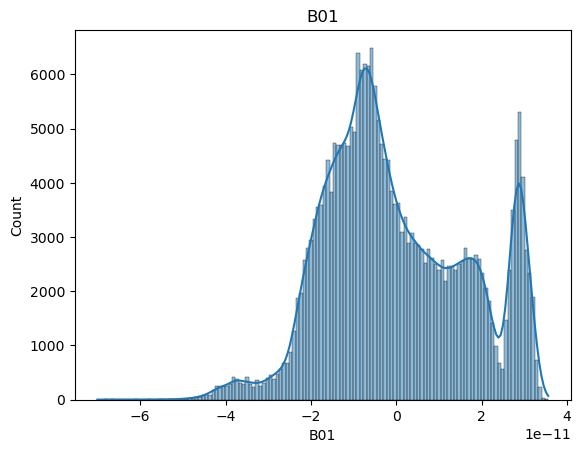

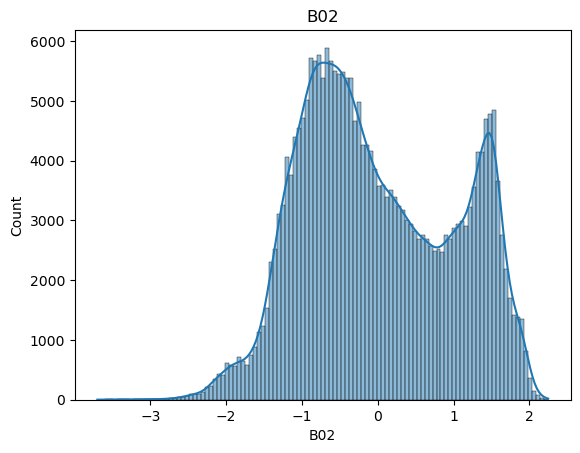

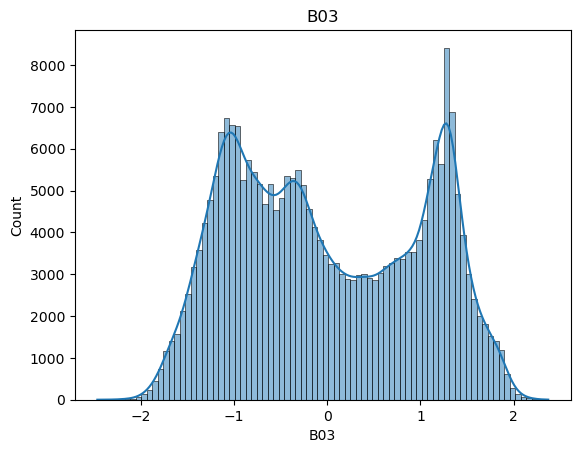

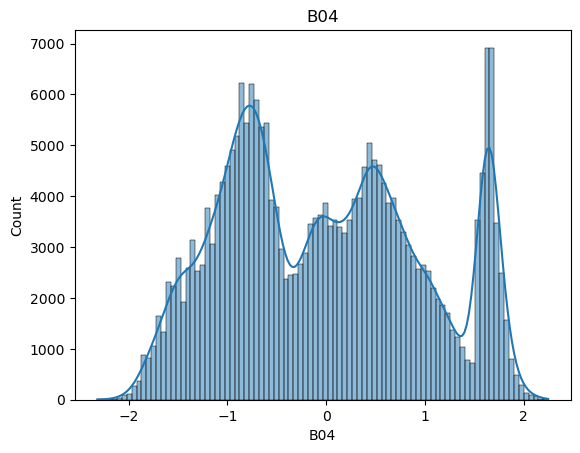

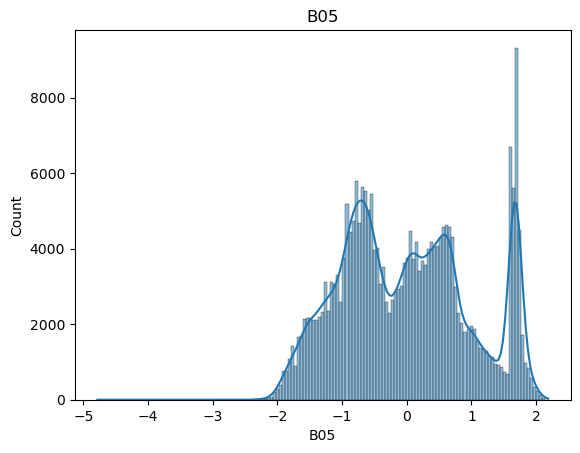

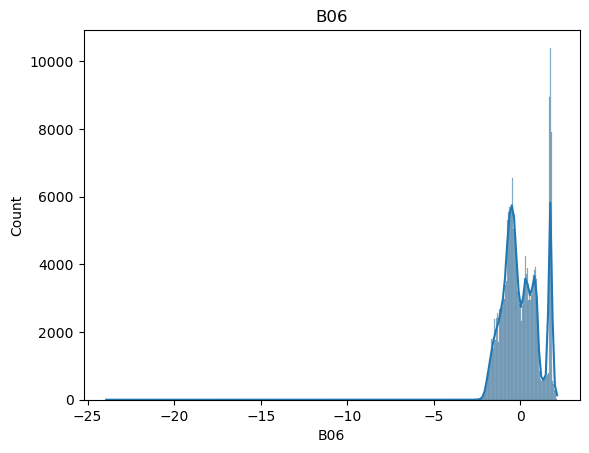

KeyboardInterrupt: 

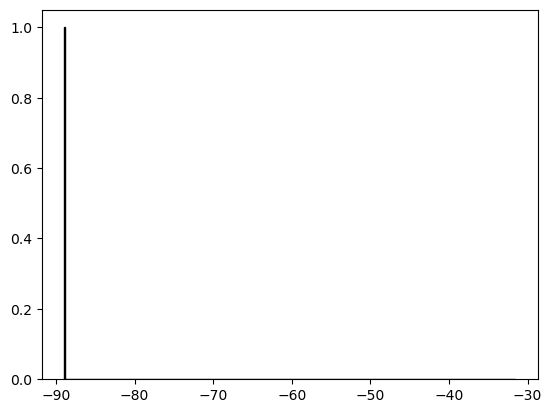

In [213]:
plot_histograms(sd)

In [ ]:
scaler = StandardScaler()

In [ ]:
rs = scaler.fit_transform(sd)

In [ ]:
rs = pd.DataFrame(rs, columns = X_train.columns)

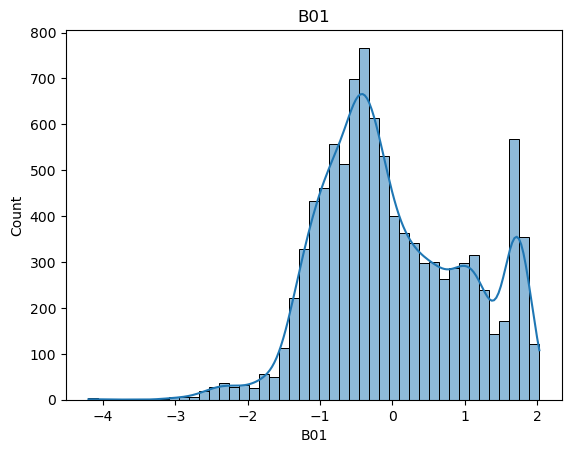

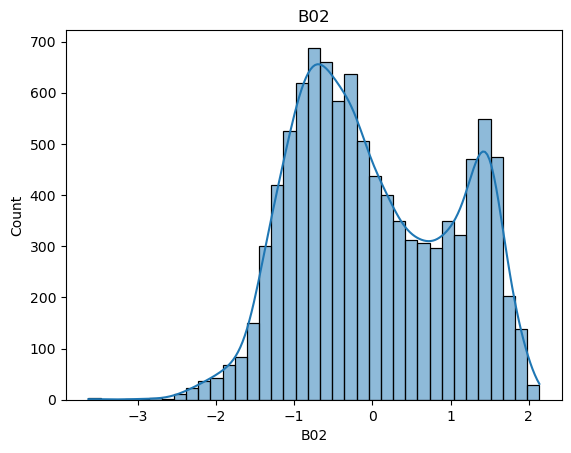

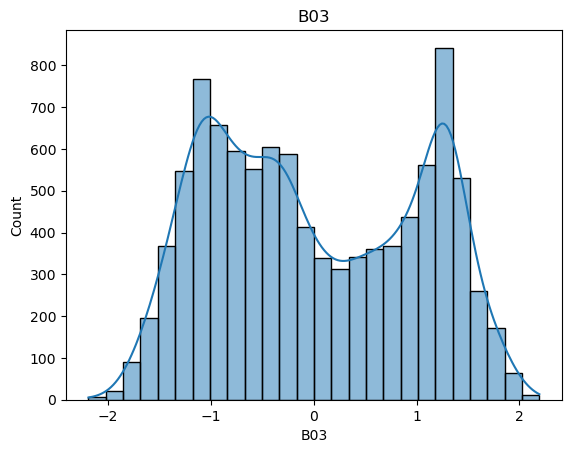

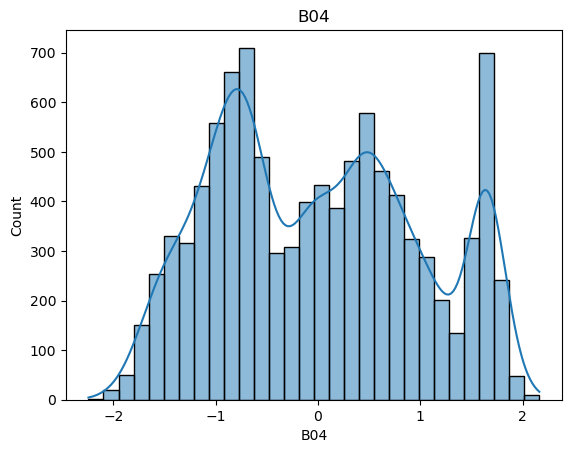

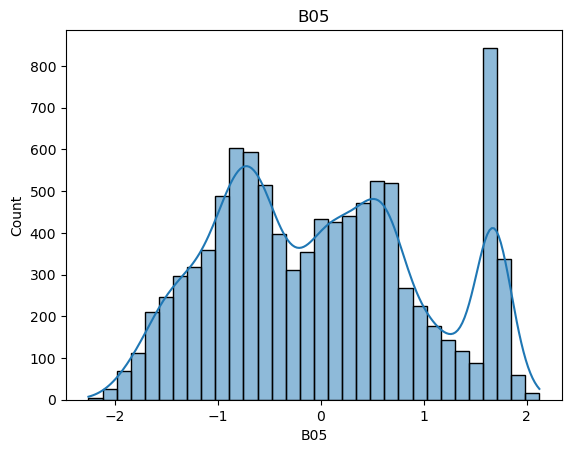

...

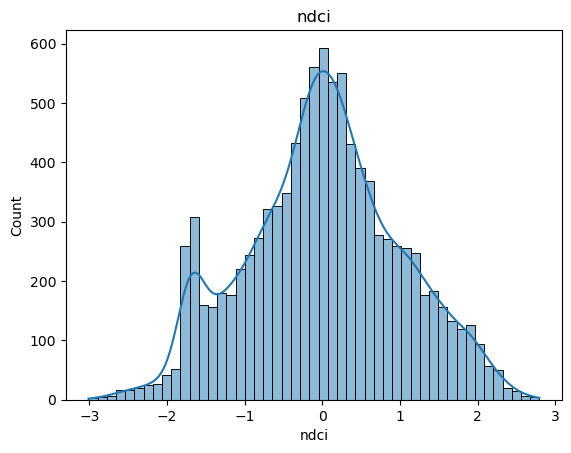

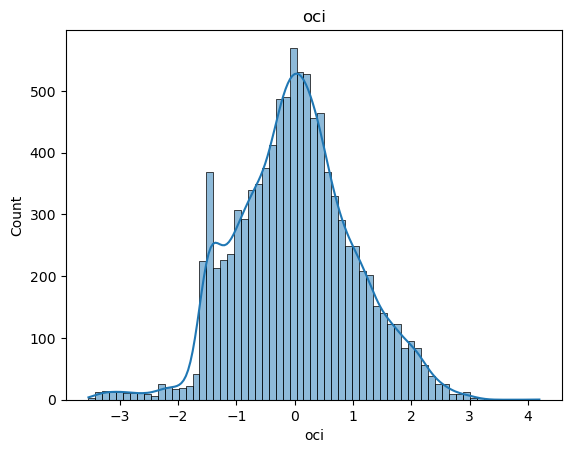

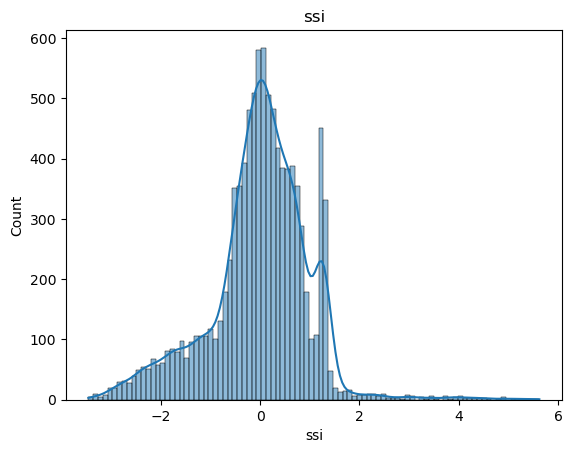

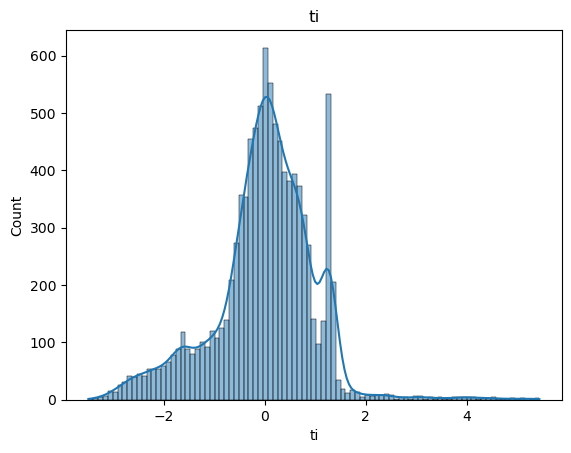

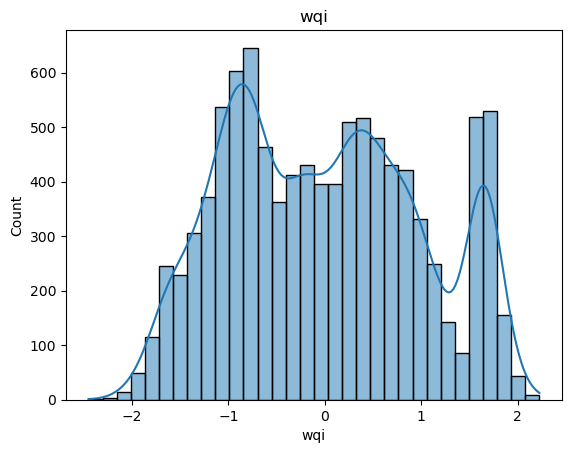

In [ ]:
plot_histograms(rs.sample(10_000, random_state = 42))

In [ ]:
pixel_df = X_train
pixel_df = pd.DataFrame(pixel_df, columns = X_train.columns)
sample_data = pixel_df.sample(100_000, random_state = 42)
pca = decomposition.PCA(n_components = 5, random_state = 42)
pca_data = pca.fit_transform(sample_data)

# pd.DataFrame(pca_data).plot.scatter(x = 0, y = 1)

In [214]:
pca.explained_variance_ratio_

array([0.8608452 , 0.09907338, 0.02271784, 0.00814489, 0.00381842])

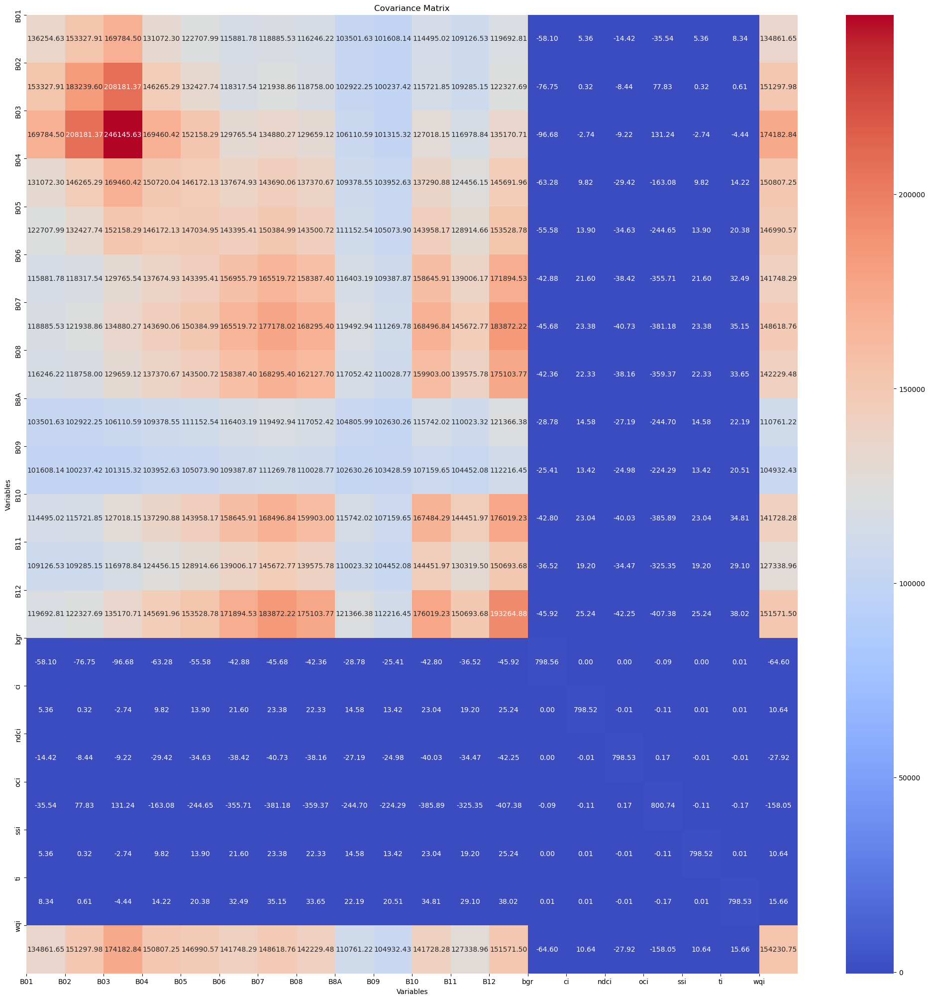

In [ ]:
plt.figure(figsize=(25,25))
sns.heatmap(pca.get_covariance(),  annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Covariance Matrix")
plt.xlabel("Variables")
plt.ylabel("Variables")
plt.xticks(range(len(X_train.columns)), X_train.columns)
plt.yticks(range(len(X_train.columns)), X_train.columns)
plt.show()

In [215]:
classes = 10

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


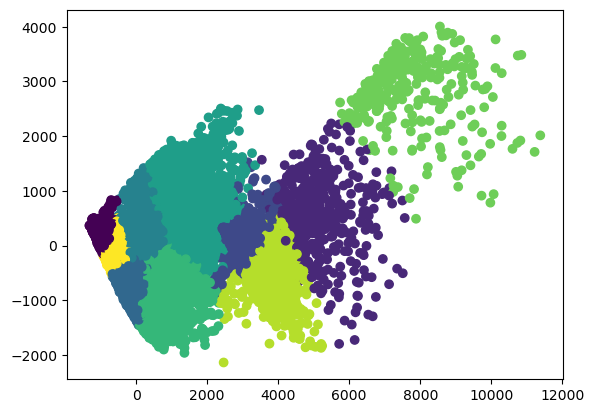

In [216]:
kmeans = KMeans(n_clusters=classes, random_state=42)
kmeans.fit(pca_data)
labels = kmeans.labels_

# Plot the reduced data and color it by the cluster labels
plt.scatter(pca_data[:, 0], pca_data[:, 1], c=labels)
plt.show()

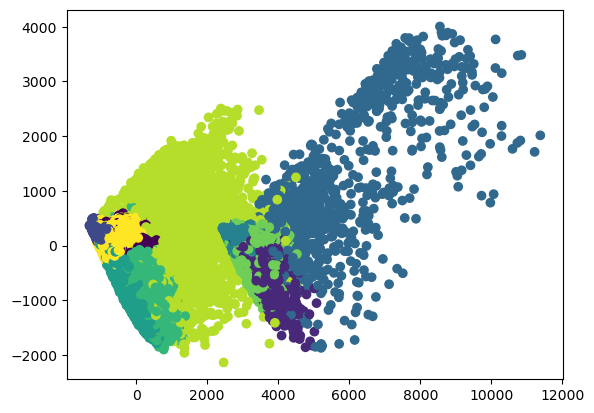

In [217]:
gm = GaussianMixture(n_components=classes, random_state=42)
gm.fit(pca_data)
labels = gm.predict(pca_data)

# Plot the reduced data and color it by the cluster labels
plt.scatter(pca_data[:, 0], pca_data[:, 1], c=labels)
plt.show()

In [218]:
import umap

In [219]:
#q how do you determine the number of neighbors for umap?
#a the optimal number 

In [223]:
reducer = umap.UMAP(min_dist = 0.5, n_neighbors = 50 , random_state = 42, metric = 'correlation')

In [224]:
embedding = reducer.fit_transform(pca_data)

In [225]:
from mpl_toolkits.mplot3d import Axes3D

/home/ziad/miniconda3/envs/ShallowLearn/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


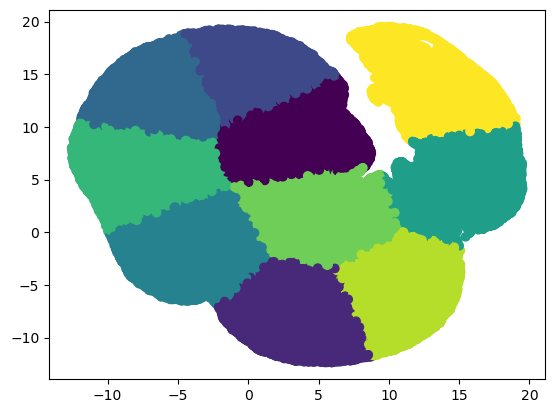

In [226]:
kmeans = KMeans(n_clusters=classes, random_state=42)
kmeans.fit(embedding)
labels = kmeans.labels_

# Plot the reduced data and color it by the cluster labels
plt.scatter(embedding[:, 0], embedding[:, 1], c=labels)
plt.show()

In [48]:
%matplotlib inline

In [227]:
sd.columns

Index(['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09',
       'B10', 'B11', 'B12', 'bgr', 'ci', 'ndci', 'oci', 'ssi', 'ti', 'wqi'],
      dtype='object')

In [228]:
sd_copy = sd.copy()

In [229]:
drop_cols = ['B12','B10','B09','B8A','B08','ti']

In [230]:
sd.drop(drop_cols, axis = 1, inplace = True)

In [231]:
sample_data.drop(drop_cols, axis = 1, inplace = True)

KeyError: "['B12', 'B10', 'B09', 'B8A', 'B08', 'ti'] not found in axis"

In [232]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split

In [233]:
X_train, X_test, y_train, y_test = train_test_split(sample_data,labels, test_size=.2)

In [234]:
bst = XGBClassifier(n_estimators=5, max_depth=8, learning_rate=1, objective='multi:softmax', num_class=len(np.unique(labels)))

In [235]:
bst.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=1, max_bin=256,
              max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
              max_depth=8, max_leaves=0, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=5, n_jobs=0, num_class=10,
              num_parallel_tree=1, objective='multi:softmax', ...)

In [236]:
preds = bst.predict(X_test)

In [237]:
from sklearn.metrics import roc_auc_score

In [238]:
preds = bst.predict_proba(X_test)

In [239]:
roc_auc_score(y_test,preds, multi_class='ovo', average='macro')

0.9969440174440998

In [240]:
feature_names

['B01',
 'B02',
 'B03',
 'B04',
 'B05',
 'B06',
 'B07',
 'B08',
 'B8A',
 'B09',
 'B10',
 'B11',
 'B12',
 'bgr',
 'ci',
 'ndci',
 'oci',
 'ssi',
 'ti',
 'wqi']

<Axes: >

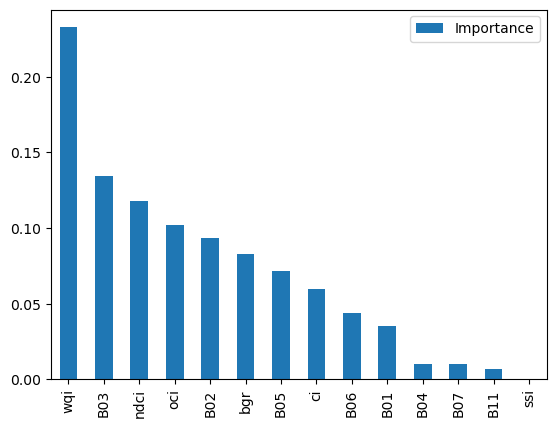

In [241]:
pd.DataFrame(bst.feature_importances_, columns = ['Importance'], index = sample_data.columns).sort_values(by = 'Importance', ascending = False).plot(kind = 'bar')

In [242]:
from sklearn.metrics import confusion_matrix

In [243]:
preds = bst.predict(X_test)

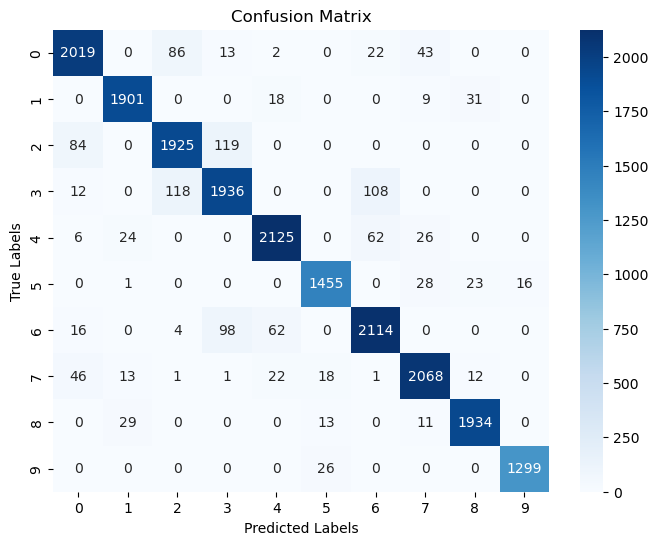

In [244]:
cm = confusion_matrix(y_test, preds)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


In [245]:
def scale_prop(arr):
    return scaler.fit_transform((pt.transform(arr)))


In [246]:
def reshape_stack(img):
    original_shape = img.shape
    test_data = pd.DataFrame(img.reshape(-1, 20), columns = feature_names)
    test_data = pd.DataFrame(scale_prop(test_data), columns = feature_names).drop(drop_cols, axis = 1)
    return test_data, original_shape


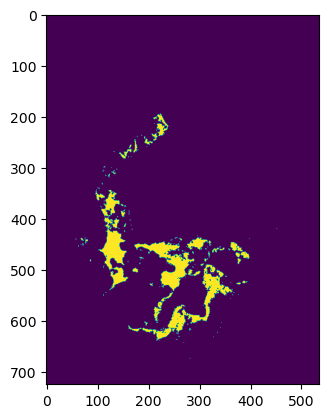

In [247]:
test_data, original_shape = reshape_stack(indice_stack[0])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

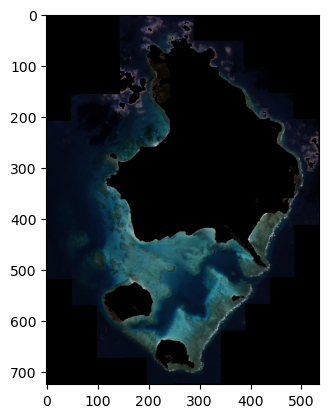

In [248]:
ih.plot_rgb(indice_stack[0], plot= True)

In [249]:
proba_ = bst.predict_proba(test_data).reshape(original_shape[:2] +  (classes,))

<Axes: ylabel='Frequency'>

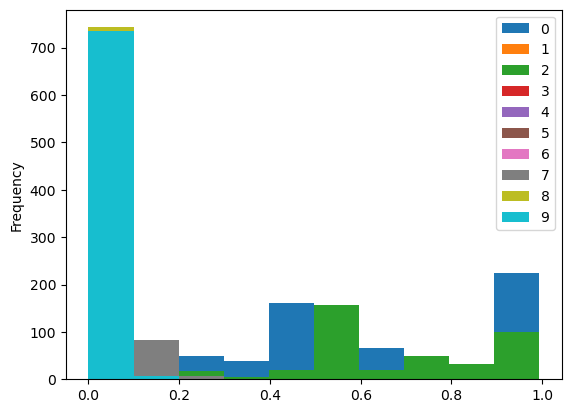

In [250]:
pd.DataFrame(proba_.reshape(-1, classes), columns = range(classes)).drop_duplicates().plot(kind = 'hist')

In [251]:
#plot_histograms(pd.DataFrame(proba_.reshape(-1, classes), columns = range(classes)))

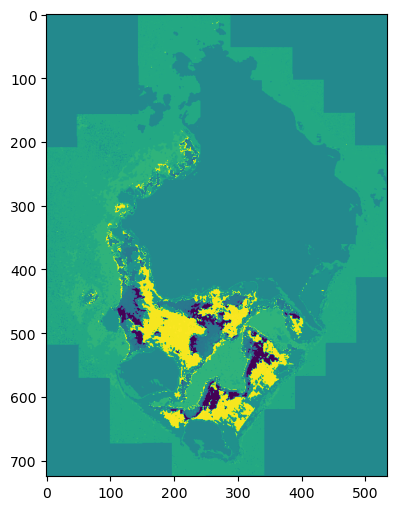

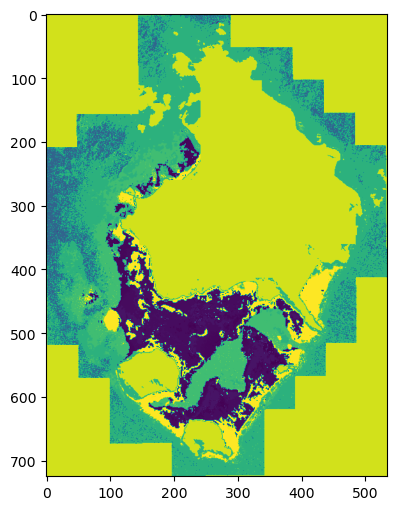

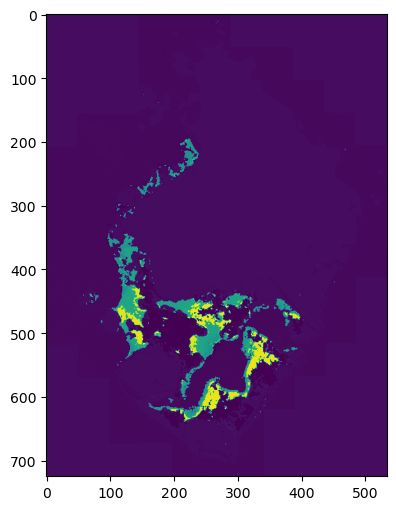

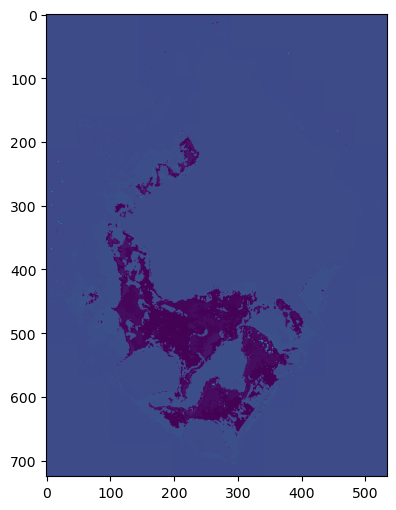

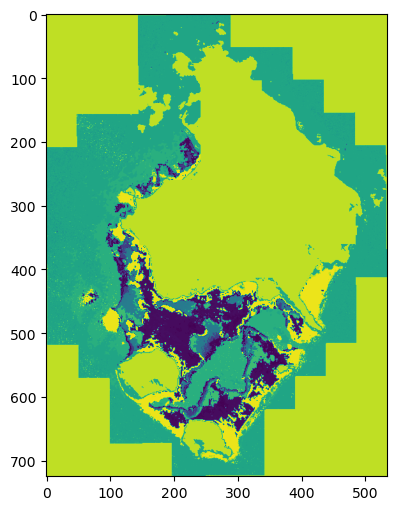

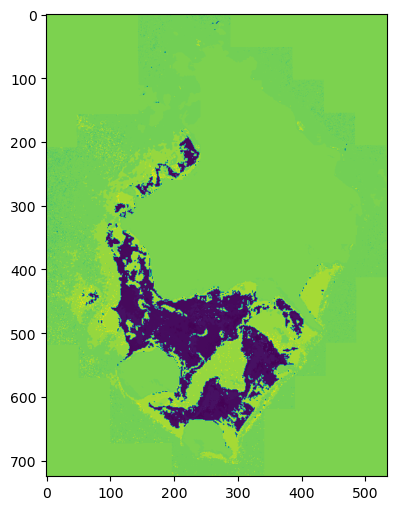

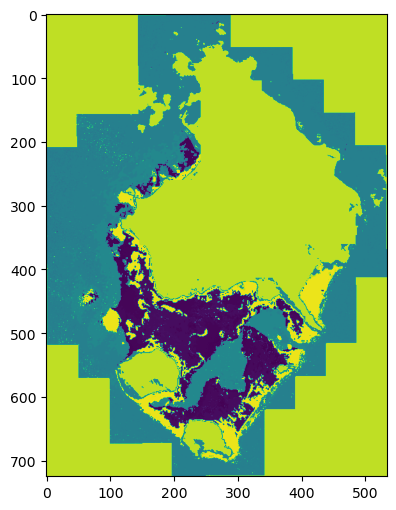

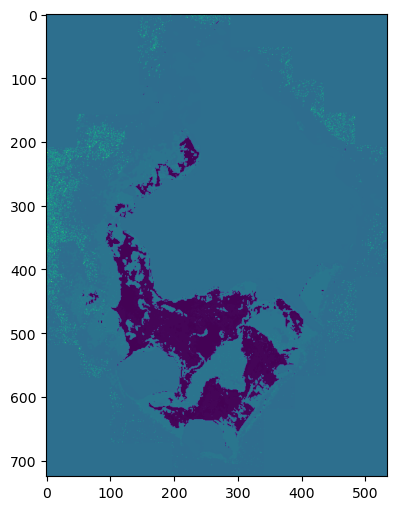

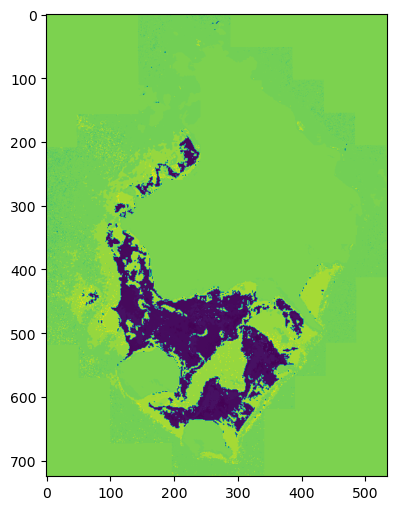

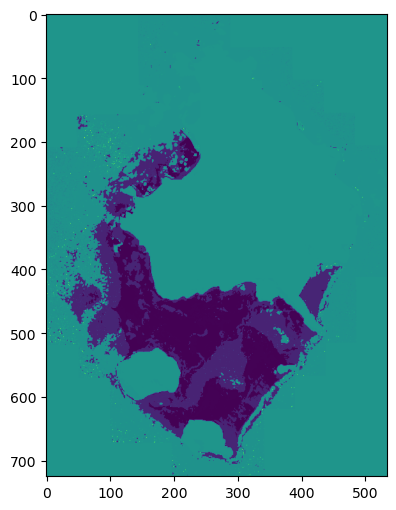

In [252]:
proba_ = bst.predict_proba(test_data).reshape(original_shape[:2] +  (classes,))
for i in range(classes):
    plt.figure(figsize=(8, 6))
    plt.imshow(proba_[:,:,i])
    plt.show()

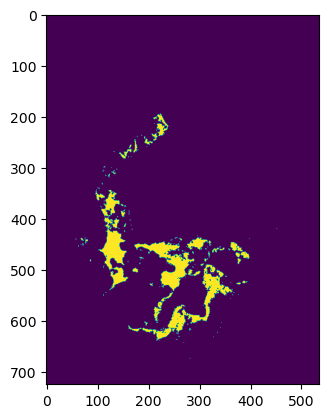

In [253]:
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

In [254]:
indice_stack[3].shape

(725, 534, 20)

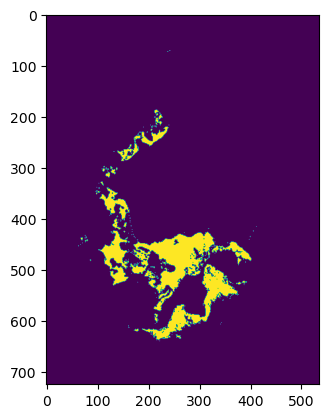

In [255]:
test_data, original_shape = reshape_stack(indice_stack[3])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

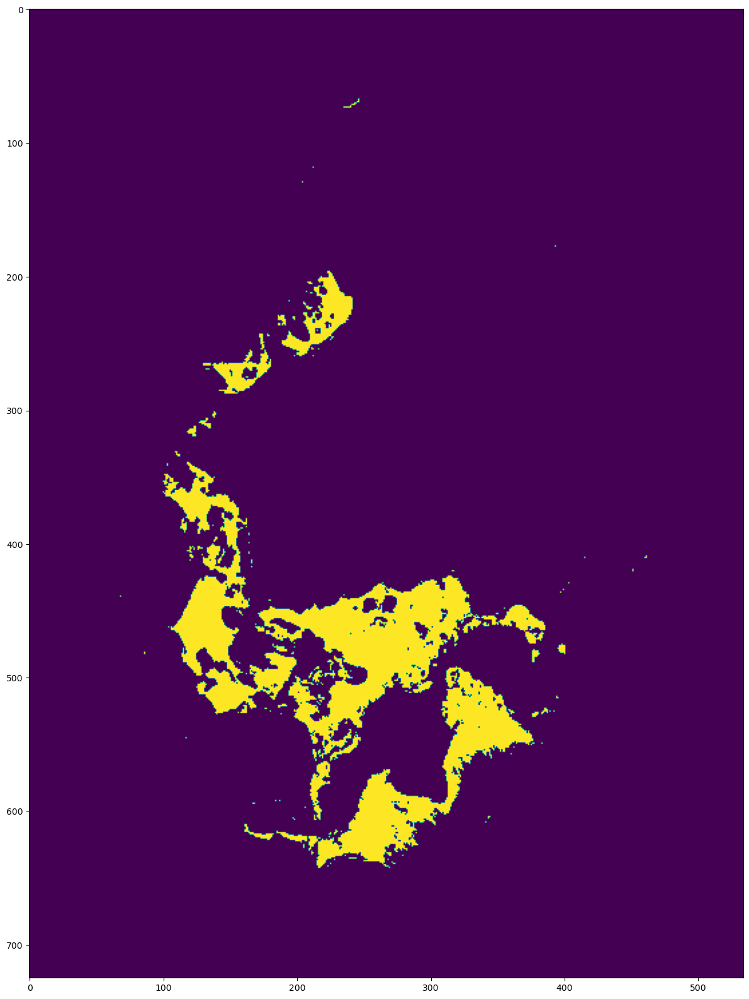

In [256]:
plt.figure(figsize=(20,20))
test_data, original_shape = reshape_stack(indice_stack[40])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

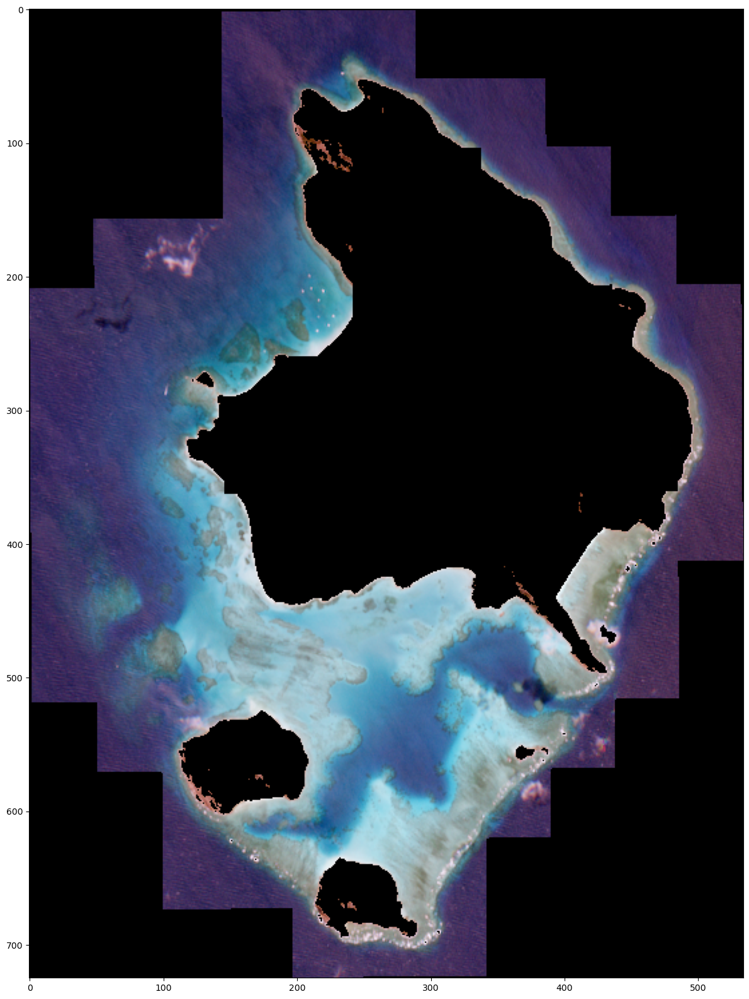

In [257]:
plt.figure(figsize=(20,20))
test_data, original_shape = reshape_stack(indice_stack[40])

ih.plot_rgb(np.array(test_data).reshape(original_shape[:2] + (len(sample_data.columns),)), plot= True)

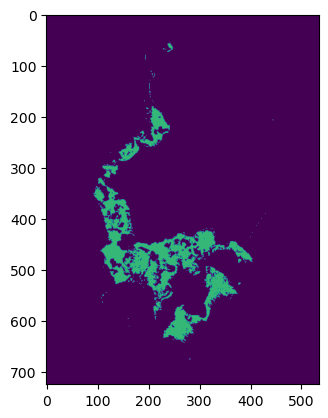

In [258]:
test_data, original_shape = reshape_stack(indice_stack[4])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

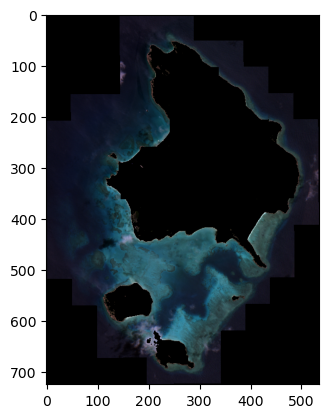

In [261]:
ih.plot_rgb(indice_stack[4], plot= True)

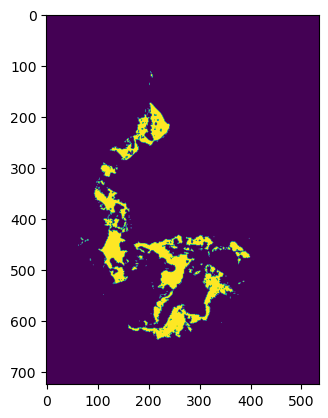

In [262]:
test_data, original_shape = reshape_stack(indice_stack[9])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

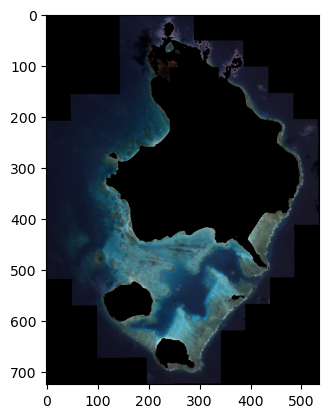

In [263]:
ih.plot_rgb(indice_stack[9], plot= True)

0.7987552656955793
0.3456459853919019


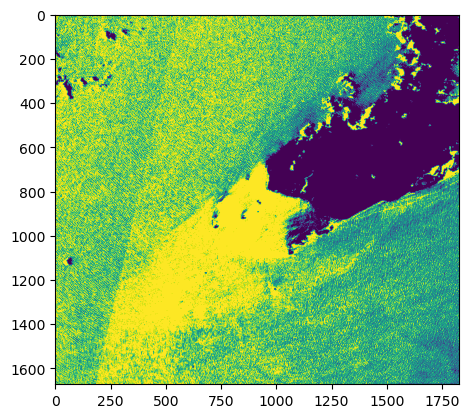

0.4009141191536836


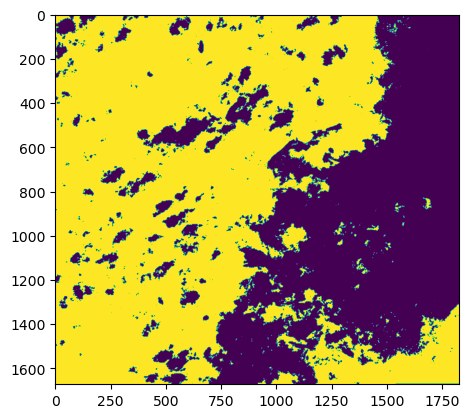

0.10494921996736879


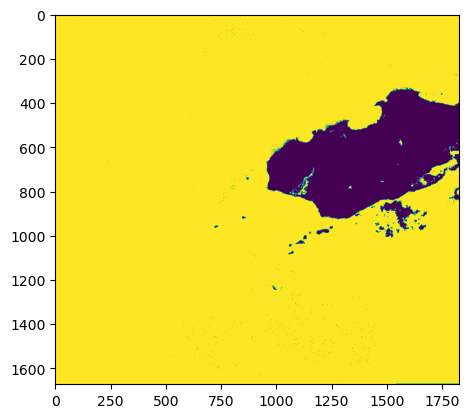

0.995418274002666
0.6838393899406182
0.13799552433853704


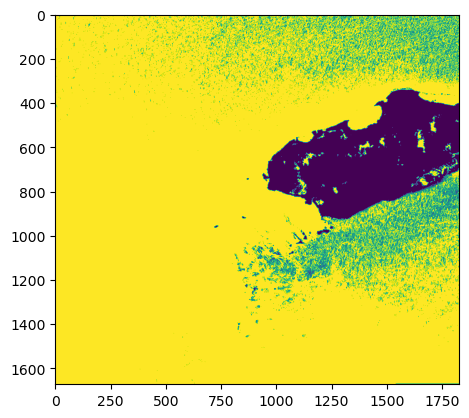

0.2243611903321522


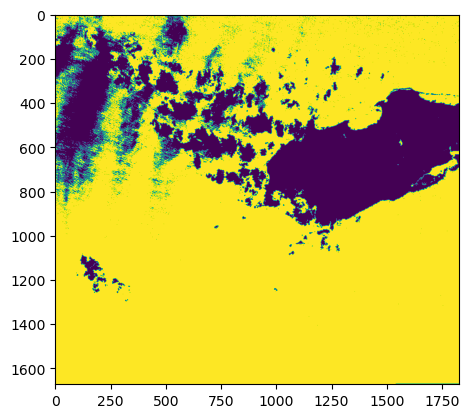

0.680347189860335
0.1936763783087947


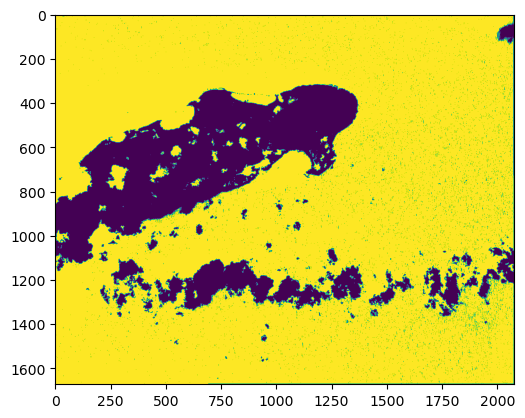

0.12012476180369394


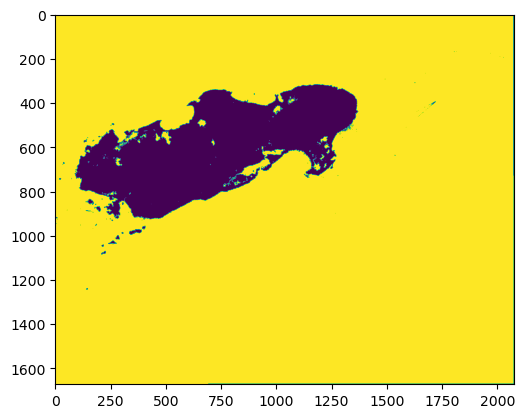

0.7092924971781596
0.09256945917562978


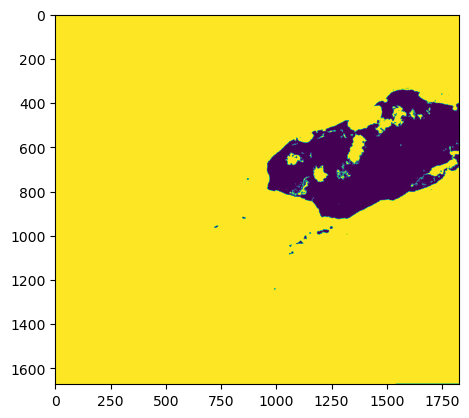

0.360938592562912


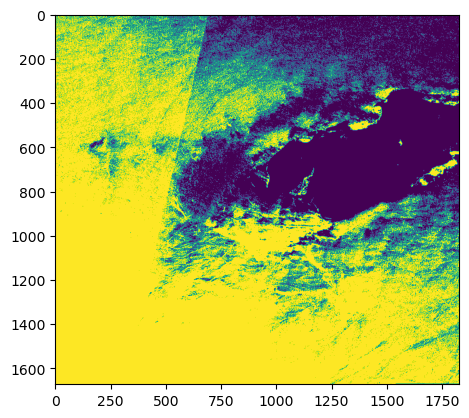

0.12473383148851351


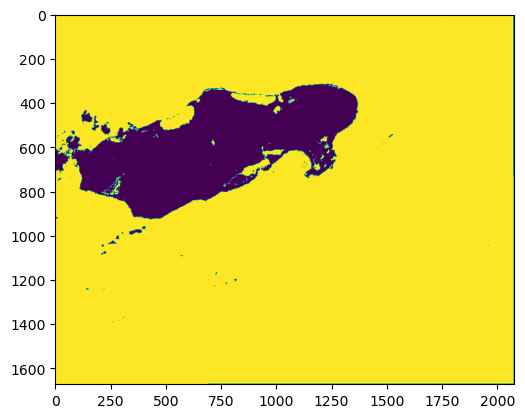

0.12476324556020542


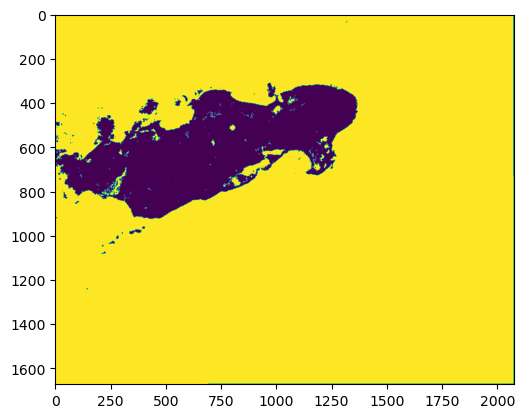

0.4735051307368975


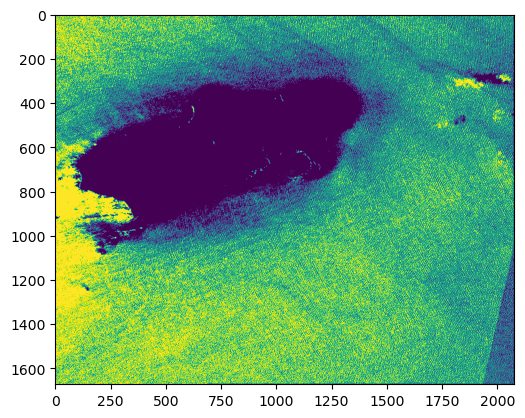

0.23528878361001773


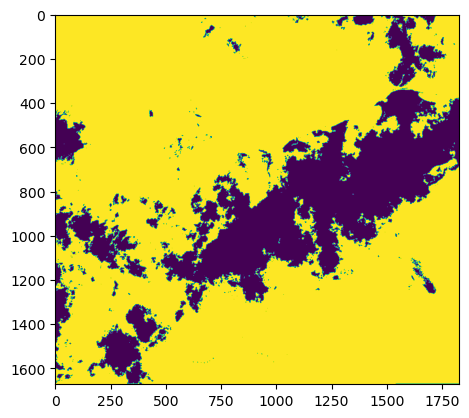

0.9229135041733377
0.9936999630738288
0.15964381958029872


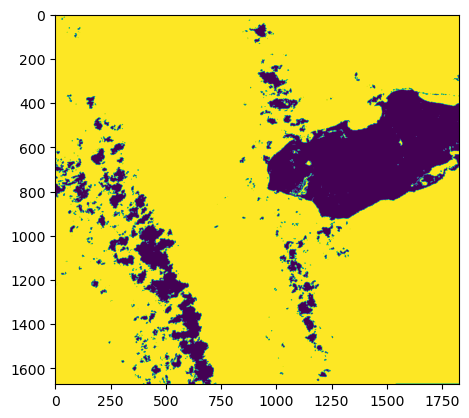

In [264]:
# data = ih.apply_mask(data, ~mask, fill_value=np.nan)
import os
import glob

# specify the directory path
dir_path = '/media/ziad/Expansion/Honduras_Clipped'

# search for all .tiff files in the directory
file_list = glob.glob(dir_path + '/*.tiff')

# get the full directory paths for each file
dir_list = [os.path.join(dir_path, f) for f in file_list]


masks = []
good_imagery = []
for i in range(len(dir_list)):
    data = load_img(dir_list[i])
    #plt.imshow(data[:,:,7])
    mask = Indices.mask_land(tf.LCE_multi(data),land_band= 'B08', threshold=15)
    mean = (np.mean(mask))
    print(mean)
    if np.mean(mask) < 0.5:
        masks.append(mask)
        good_imagery.append(data)
        plt.imshow(~mask)
        plt.show()
    if i == 20:
        break


In [265]:
clipped_imagery = []
for img, mask in zip(good_imagery, masks):
    clipped_imagery.append((ih.apply_mask(img, ~mask, fill_value=np.nan)))


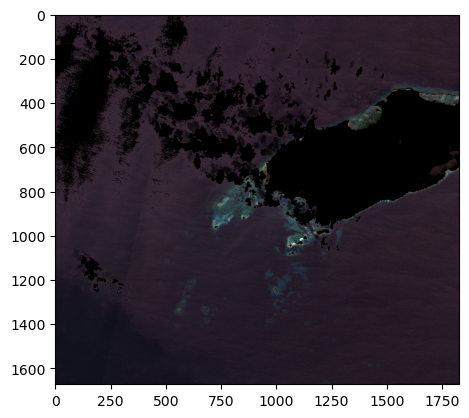

In [266]:
ih.plot_rgb(clipped_imagery[4], plot= True)

In [267]:
# features = GenerateIndicesPerImage(data)


indice_stack = []
for img in clipped_imagery:
    empty_arr = np.zeros(img[:,:,0].shape, dtype = np.float32)
    result_test = np.insert(img, 11, empty_arr, axis = 2)
    features = GenerateIndicesPerImage(result_test)
    concated_array = np.concatenate((result_test, features.indices), axis = 2)
    indice_stack.append(concated_array)

[('bgr', <function bgr at 0x7f1f5eb84d30>), ('ci', <function ci at 0x7f1fc2ec24d0>), ('get_band_numbers', <function get_band_numbers at 0x7f1f5eb84e50>), ('mask_land', <function mask_land at 0x7f1f5eb84dc0>), ('ndci', <function ndci at 0x7f1f5eb84ca0>), ('oci', <function oci at 0x7f1f5eb84a60>), ('ssi', <function ssi at 0x7f1f5eb84af0>), ('ti', <function ti at 0x7f1f5eb84b80>), ('validate_band_shape', <function validate_band_shape at 0x7f1f5eb84ee0>), ('wqi', <function wqi at 0x7f1f5eb84c10>)]
[('bgr', <function bgr at 0x7f1f5eb84d30>), ('ci', <function ci at 0x7f1fc2ec24d0>), ('ndci', <function ndci at 0x7f1f5eb84ca0>), ('oci', <function oci at 0x7f1f5eb84a60>), ('ssi', <function ssi at 0x7f1f5eb84af0>), ('ti', <function ti at 0x7f1f5eb84b80>), ('wqi', <function wqi at 0x7f1f5eb84c10>)]
['bgr', 'ci', 'ndci', 'oci', 'ssi', 'ti', 'wqi']
[('bgr', <function bgr at 0x7f1f5eb84d30>), ('ci', <function ci at 0x7f1fc2ec24d0>), ('get_band_numbers', <function get_band_numbers at 0x7f1f5eb84e50>)

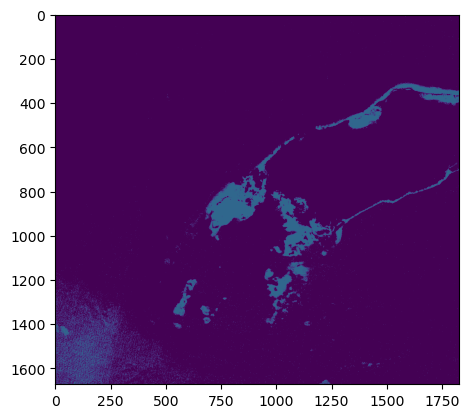

In [268]:
test_data, original_shape = reshape_stack(indice_stack[4])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

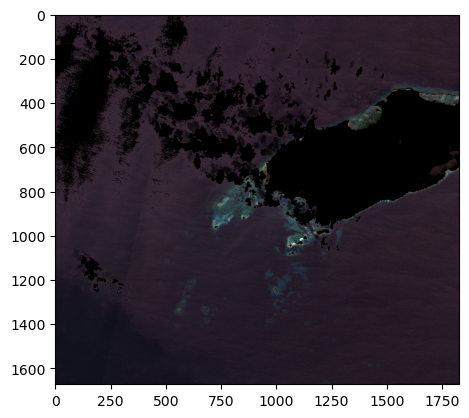

In [269]:
ih.plot_rgb(indice_stack[4], plot= True)

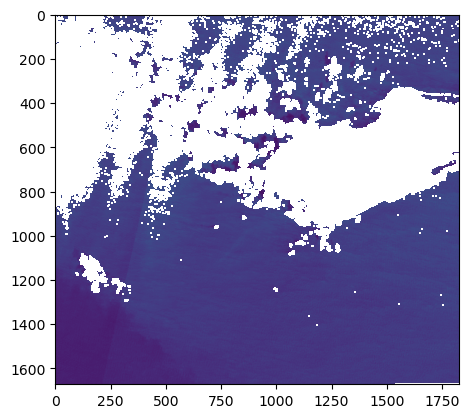

In [270]:
plt.imshow(indice_stack[4][:,:,8])

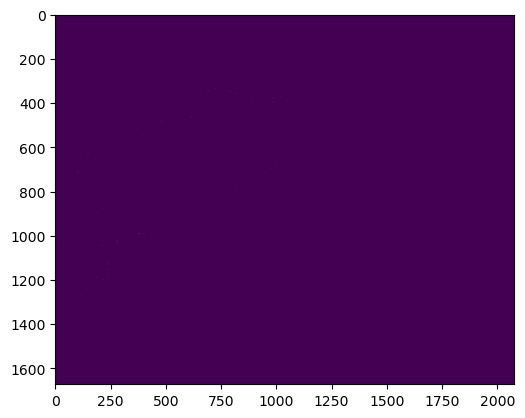

In [271]:
test_data, original_shape = reshape_stack(indice_stack[5])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]) == 3)

In [272]:
np.unique(bst.predict(test_data).reshape(original_shape[:2]))

array([0, 2, 3, 6], dtype=int32)

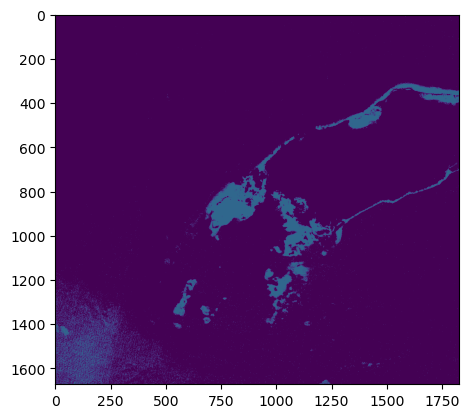

In [273]:
test_data, original_shape = reshape_stack(indice_stack[4])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

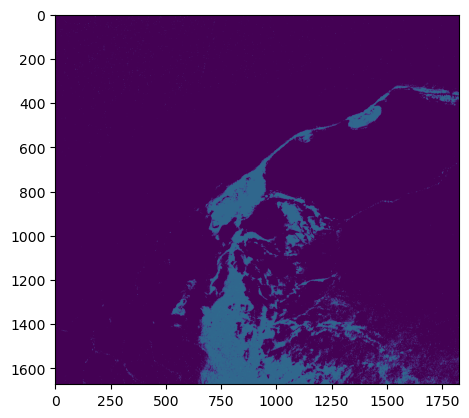

In [274]:
test_data, original_shape = reshape_stack(indice_stack[3])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))

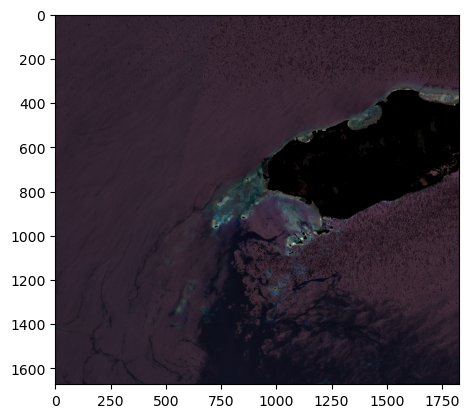

In [275]:
ih.plot_rgb(indice_stack[3], plot= True)

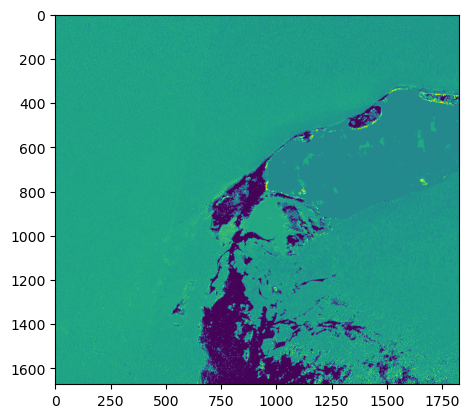

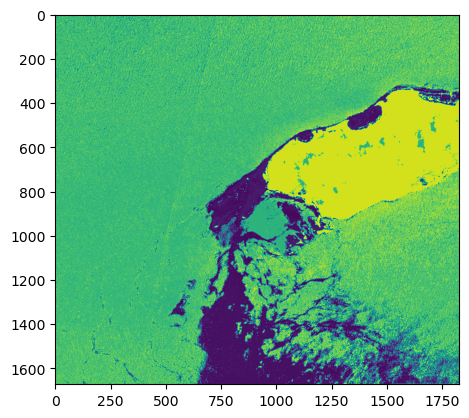

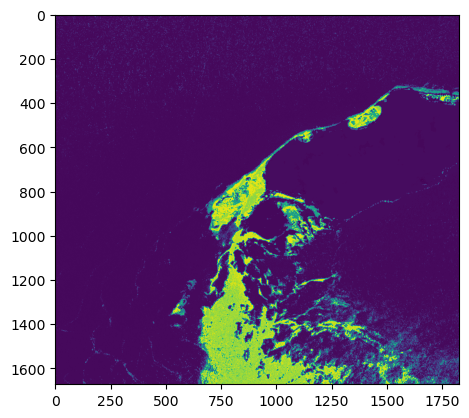

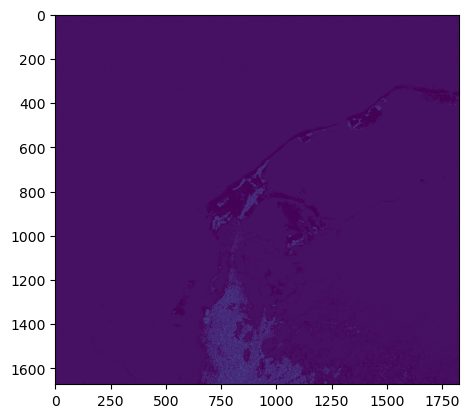

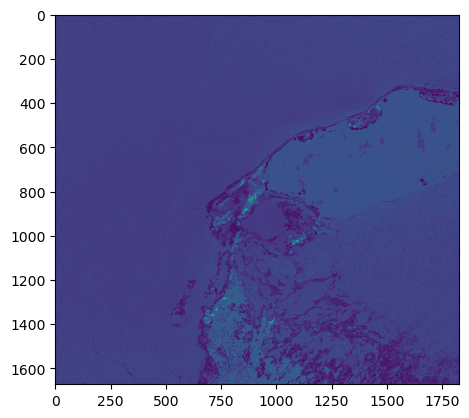

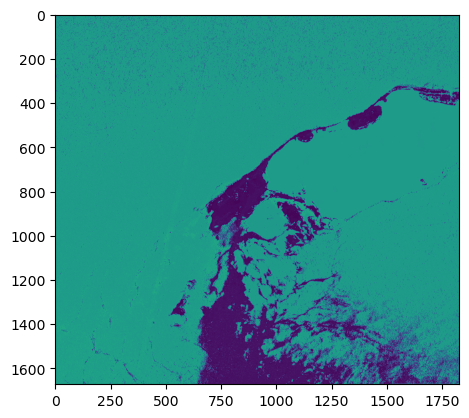

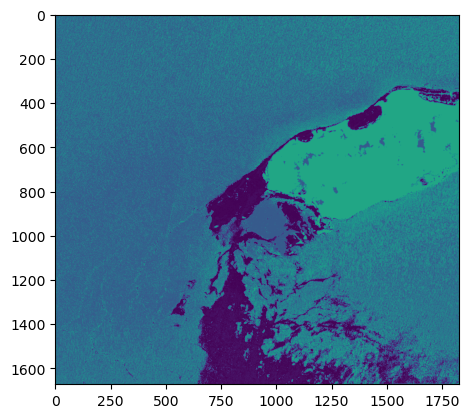

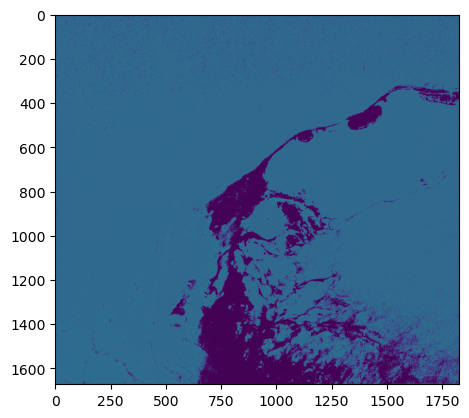

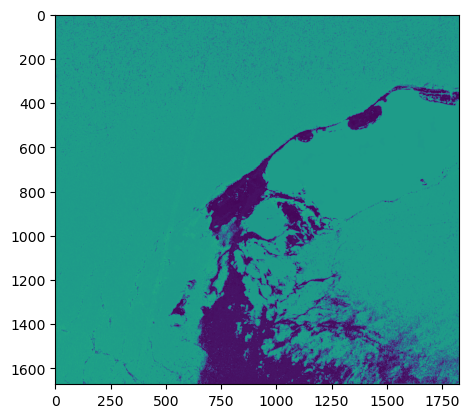

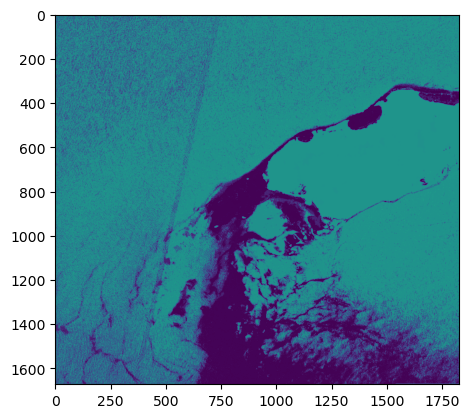

In [276]:
proba_ = bst.predict_proba(test_data).reshape(original_shape[:2] +  (classes,))
for i in range(classes):
    plt.imshow(proba_[:,:,i])
    plt.show()

(array([ 20120., 226196., 118612., 120260., 245299., 585645., 611119.,
        359450., 213633., 132869.]),
 array([  1. ,  75.4, 149.8, 224.2, 298.6, 373. , 447.4, 521.8, 596.2,
        670.6, 745. ]),
 <BarContainer object of 10 artists>)

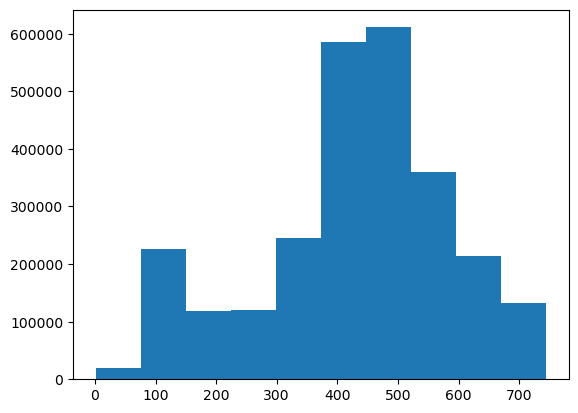

In [277]:
plt.hist(indice_stack[3][:,:,7].reshape(-1,1))

In [278]:
path = "/media/ziad/Expansion/London/"

In [279]:
directories = os.listdir(path)

In [280]:
directories

['S2A_MSIL2A_20230610T110621_N0509_R137_T30UXC_20230610T165306.zip.tiff']

In [281]:
london = load_img(path + directories[0])

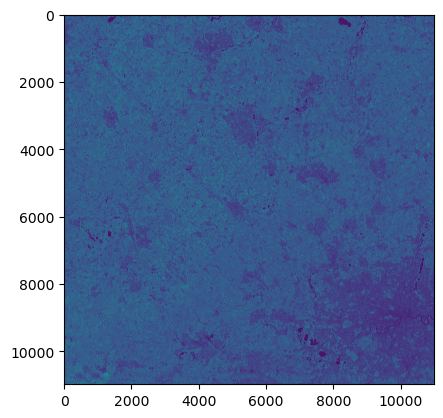

In [ ]:
plt.imshow(london[:,:,7])

In [292]:
mask = Indices.mask_land(tf.LCE_multi(london),land_band= 'B08', threshold=20)

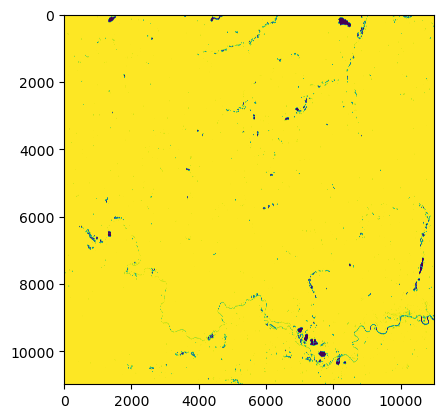

In [293]:
plt.imshow(mask)

In [197]:
masked_london = ih.apply_mask(london, ~mask, fill_value=np.nan)

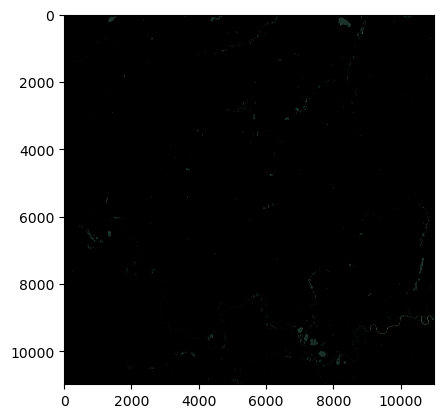

In [198]:
ih.plot_rgb(masked_london, plot= True)

In [199]:
# features = GenerateIndicesPerImage(data)

empty_arr = np.zeros(masked_london[:,:,0].shape, dtype = np.float32)
result_test = np.insert(masked_london, 11, empty_arr, axis = 2)
features = GenerateIndicesPerImage(result_test)
concated_array = np.concatenate((result_test, features.indices), axis = 2)


[('bgr', <function bgr at 0x7f28e3d6ee60>), ('ci', <function ci at 0x7f28e3d6f880>), ('get_band_numbers', <function get_band_numbers at 0x7f28e3d880d0>), ('mask_land', <function mask_land at 0x7f28e3d6eb00>), ('ndci', <function ndci at 0x7f28e3d6e320>), ('oci', <function oci at 0x7f28e3d6c160>), ('ssi', <function ssi at 0x7f28e3d6d090>), ('ti', <function ti at 0x7f28e3d6ca60>), ('validate_band_shape', <function validate_band_shape at 0x7f28e3d895a0>), ('wqi', <function wqi at 0x7f28e3d6edd0>)]
[('bgr', <function bgr at 0x7f28e3d6ee60>), ('ci', <function ci at 0x7f28e3d6f880>), ('ndci', <function ndci at 0x7f28e3d6e320>), ('oci', <function oci at 0x7f28e3d6c160>), ('ssi', <function ssi at 0x7f28e3d6d090>), ('ti', <function ti at 0x7f28e3d6ca60>), ('wqi', <function wqi at 0x7f28e3d6edd0>)]


: 

: 

In [ ]:
test_data, original_shape = reshape_stack(indice_stack[3])
plt.imshow(bst.predict(test_data).reshape(original_shape[:2]))